In [1]:
# Install Ultralytics (YOLOv8)
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 26.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 44.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.9.41
    Uninstalling nvidia-nvjitlink-cu12-12.9.41:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.9.41
  Attempting uninstall: nvidia-curand-cu12
    Found existing installation: nvidia-curand-cu12 10.3.10.19
    Uninstalling nvidia-curand-cu12-10.3

In [2]:
# Importar bibliotecas
import os
from ultralytics import YOLO
import torch
from ultralytics.nn.tasks import DetectionModel
from torch.nn.modules.container import Sequential
from ultralytics.nn.modules import Conv

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
# PyTorch security settings
torch.serialization.add_safe_globals([DetectionModel, Sequential, Conv])

In [4]:
# Load pre-trained model
model = YOLO('yolov8s.pt')  # n=nano, s=small, m=medium, l=large, x=xlarge
# Train the model
results = model.train(
    data='/kaggle/input/food-images-and-labels-dataset-for-yolov5/data.yaml',  # Path in Kaggle
    epochs=200,
    imgsz=640,
    batch=16,
    name='food_detection',
    project='/kaggle/working/YOLOv8_Food_Detection',  # Save in working directory
    patience=50
)

100%|██████████| 21.5M/21.5M [00:00<00:00, 193MB/s]


Ultralytics 8.3.158 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/food-images-and-labels-dataset-for-yolov5/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=food_detection, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patie

100%|██████████| 755k/755k [00:00<00:00, 29.7MB/s]


Overriding model.yaml nc=80 with nc=12

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 36.3MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 7.4±3.7 MB/s, size: 59.6 KB)


train: Scanning /kaggle/input/food-images-and-labels-dataset-for-yolov5/train/labels... 704 images, 3 backgrounds, 0 corrupt: 100%|██████████| 704/704 [00:03<00:00, 191.02it/s]


WARNING ⚠️ train: Cache directory /kaggle/input/food-images-and-labels-dataset-for-yolov5/train is not writeable, cache not saved.
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 949, len(boxes) = 1028. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 7.0±1.9 MB/s, size: 38.2 KB)


val: Scanning /kaggle/input/food-images-and-labels-dataset-for-yolov5/valid/labels... 65 images, 1 backgrounds, 0 corrupt: 100%|██████████| 65/65 [00:00<00:00, 181.91it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/food-images-and-labels-dataset-for-yolov5/valid is not writeable, cache not saved.
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 105, len(boxes) = 114. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


Plotting labels to /kaggle/working/YOLOv8_Food_Detection/food_detection/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000625, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to /kaggle/working/YOLOv8_Food_Detection/food_detection
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/200      4.26G     0.8862      3.596       1.44         58        640: 100%|██████████| 44/44 [00:14<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]

                   all         65        114      0.706      0.577      0.639      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/200      4.29G     0.7433      1.678      1.299         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.45it/s]

                   all         65        114      0.615      0.644      0.713      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/200      4.33G     0.7699      1.396      1.314         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.63it/s]

                   all         65        114       0.74      0.444       0.62      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/200      4.37G     0.8383      1.242      1.356         64        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]

                   all         65        114      0.615      0.546      0.598      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/200       4.4G      0.785      1.207      1.314         52        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.61it/s]

                   all         65        114      0.445      0.527      0.511      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/200      4.44G     0.7875      1.175      1.315         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.59it/s]

                   all         65        114      0.513      0.607      0.508      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/200      4.47G     0.7929      1.152      1.325         66        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]

                   all         65        114       0.71      0.645      0.694      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/200      4.51G     0.7749        1.1      1.318         60        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.61it/s]

                   all         65        114      0.708      0.655      0.711      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/200      4.55G     0.7749      1.028      1.295         43        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.56it/s]

                   all         65        114      0.597      0.635      0.656      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/200      4.58G     0.7301      1.017      1.284         42        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.74it/s]

                   all         65        114      0.619      0.837      0.843      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/200      4.62G     0.7254     0.9398      1.264         64        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.53it/s]

                   all         65        114      0.718       0.62      0.663      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/200      4.66G      0.724     0.9748       1.28         48        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]

                   all         65        114      0.757      0.767      0.779      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/200      4.69G     0.6772     0.8803      1.237         52        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.75it/s]

                   all         65        114      0.666      0.592      0.721      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/200      4.73G     0.6763     0.8461      1.236         57        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.59it/s]

                   all         65        114      0.653      0.653      0.692      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/200      4.77G     0.6961     0.8762      1.252         49        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.54it/s]

                   all         65        114       0.68      0.643        0.7      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/200       4.8G     0.6798     0.8178      1.248         43        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.60it/s]

                   all         65        114      0.717      0.678      0.757      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/200      4.84G     0.6766     0.8206      1.241         50        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.63it/s]

                   all         65        114      0.743      0.776      0.811      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/200      4.88G     0.6356     0.7676      1.204         39        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.60it/s]

                   all         65        114      0.774      0.715      0.837      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/200      4.91G     0.6198     0.7265      1.174         45        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.64it/s]

                   all         65        114      0.801      0.798      0.869      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/200      4.95G     0.6648     0.7589      1.222         52        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.72it/s]

                   all         65        114      0.809      0.747      0.817      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/200      4.98G     0.6344      0.741       1.21         56        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]

                   all         65        114      0.706      0.792      0.824      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/200      5.02G     0.6124     0.6821      1.185         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.63it/s]

                   all         65        114      0.761      0.795      0.825      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/200      5.06G     0.6145     0.7238      1.186         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.69it/s]

                   all         65        114      0.764      0.674      0.829      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/200      5.09G     0.5975     0.7232      1.169         70        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.68it/s]

                   all         65        114      0.716      0.796      0.783      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/200      5.13G     0.5924     0.6754      1.185         41        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.74it/s]

                   all         65        114      0.634      0.836      0.839      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/200      5.17G     0.5739     0.6307      1.149         51        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]

                   all         65        114      0.797      0.784      0.797      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/200       5.2G     0.5954     0.6566      1.164         60        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.59it/s]

                   all         65        114      0.621      0.729      0.736       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/200      5.24G     0.5915     0.6563      1.167         45        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.62it/s]

                   all         65        114      0.694      0.722      0.747      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/200       5.5G     0.5757     0.6137      1.156         48        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.50it/s]

                   all         65        114      0.788      0.752      0.817       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/200      5.53G     0.5967     0.6499      1.179         63        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.60it/s]

                   all         65        114      0.737      0.743       0.79      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/200      5.57G     0.5632     0.6031      1.142         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.59it/s]

                   all         65        114      0.792      0.773      0.787      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/200      5.61G     0.5611     0.5912       1.13         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.62it/s]

                   all         65        114       0.88       0.78      0.856      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/200      5.64G     0.5589     0.5987      1.141         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.74it/s]

                   all         65        114      0.833      0.806      0.839      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/200      5.68G     0.5415     0.5844      1.132         43        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.59it/s]

                   all         65        114      0.667       0.76      0.746       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/200      5.71G     0.5433     0.5713      1.134         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.68it/s]

                   all         65        114       0.73      0.798      0.812      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/200      5.75G     0.5525      0.606      1.138         52        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.70it/s]

                   all         65        114      0.734      0.718      0.784      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/200      6.01G     0.5338     0.5834      1.124         65        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.70it/s]

                   all         65        114      0.751      0.751      0.764      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/200      6.05G     0.5278     0.5664       1.12         56        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.71it/s]

                   all         65        114      0.746      0.735      0.794      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/200      6.08G     0.5453     0.5604      1.129         66        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]

                   all         65        114      0.673      0.771      0.758       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/200      6.12G     0.5154     0.5495      1.102         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.71it/s]

                   all         65        114      0.747      0.769      0.758      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/200      6.16G     0.5249     0.5455      1.115         64        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.61it/s]

                   all         65        114      0.802      0.787      0.869      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/200      6.19G     0.5153     0.5348        1.1         36        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.62it/s]

                   all         65        114      0.776       0.72      0.792      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/200      6.23G     0.5178     0.5022      1.103         58        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.70it/s]

                   all         65        114      0.727      0.753      0.751      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/200      6.26G      0.527     0.5214      1.116         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.15it/s]

                   all         65        114      0.808      0.776      0.802      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/200      6.52G     0.5159     0.5065      1.104         48        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.69it/s]

                   all         65        114      0.852      0.715      0.801       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/200      6.56G     0.5034     0.5155      1.095         55        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.79it/s]

                   all         65        114      0.923      0.779      0.901       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/200       6.6G     0.4995     0.5007        1.1         65        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.86it/s]

                   all         65        114      0.716      0.765      0.745      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/200      6.63G     0.4976     0.4956      1.095         60        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.78it/s]

                   all         65        114      0.747      0.757      0.755       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/200      6.67G     0.5029     0.4981      1.095         67        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.79it/s]

                   all         65        114      0.757      0.745        0.8      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/200      6.71G     0.4866     0.4892      1.095         51        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.85it/s]

                   all         65        114      0.717      0.763      0.794      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/200      6.74G     0.4976     0.4827      1.095         63        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.79it/s]

                   all         65        114      0.879      0.741      0.838      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/200      6.78G     0.4908     0.4742      1.087         68        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.88it/s]

                   all         65        114      0.803      0.681      0.787      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/200      7.04G     0.4837      0.462      1.079         58        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.44it/s]

                   all         65        114      0.747      0.865      0.881       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/200      7.07G     0.4733     0.4589      1.082         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.69it/s]

                   all         65        114      0.844      0.735      0.804      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/200      7.11G     0.4817     0.4748      1.077         51        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.79it/s]

                   all         65        114      0.869      0.745      0.854      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/200      7.14G     0.4761      0.467      1.081         55        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]

                   all         65        114      0.755      0.777      0.827      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/200      7.18G     0.4689     0.4615      1.074         50        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.60it/s]

                   all         65        114      0.893      0.719      0.851      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/200      7.22G     0.4611     0.4463      1.077         46        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.42it/s]

                   all         65        114      0.831       0.73      0.781      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/200      7.25G     0.4687     0.4464      1.075         48        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.77it/s]

                   all         65        114      0.792       0.74      0.788      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/200      7.29G     0.4509     0.4514      1.058         57        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.76it/s]

                   all         65        114      0.881      0.791      0.847      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/200      7.55G     0.4241     0.4121      1.047         64        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.76it/s]

                   all         65        114      0.866      0.801      0.851      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/200      7.58G     0.4567     0.4396       1.07         64        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.72it/s]

                   all         65        114      0.695      0.705      0.713      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/200      7.62G     0.4567     0.4275      1.061         42        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.61it/s]

                   all         65        114      0.799      0.752      0.818      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/200      7.66G     0.4409     0.4358       1.06         57        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.76it/s]

                   all         65        114      0.808      0.741      0.793      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/200      7.69G     0.4449     0.4286      1.059         48        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.85it/s]

                   all         65        114      0.855      0.825      0.856      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/200      7.73G     0.4479     0.4371      1.061         38        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.84it/s]

                   all         65        114      0.816      0.807      0.873      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/200      7.77G      0.436     0.4165      1.051         57        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.69it/s]

                   all         65        114      0.865      0.759      0.828       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/200       7.8G     0.4274     0.4061      1.039         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.56it/s]

                   all         65        114      0.857      0.755      0.841      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/200      8.06G     0.4236     0.4097      1.046         44        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.87it/s]

                   all         65        114      0.749      0.726      0.736      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/200      4.46G     0.4362     0.4098      1.059         44        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.83it/s]

                   all         65        114      0.788      0.816      0.845      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/200      4.46G     0.4166     0.3875      1.041         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.38it/s]

                   all         65        114      0.801      0.732      0.822      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/200      4.46G     0.4285     0.3984      1.043         58        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.80it/s]

                   all         65        114      0.692       0.79      0.763      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/200      4.46G     0.4029     0.3792      1.032         58        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.62it/s]

                   all         65        114       0.72      0.798      0.767      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/200      4.46G     0.4086      0.379      1.032         37        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.91it/s]

                   all         65        114      0.849      0.794      0.862      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/200      4.46G     0.4085     0.4076      1.042         70        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.50it/s]

                   all         65        114      0.871      0.748      0.847      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/200       4.5G     0.4113     0.3852      1.038         50        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.63it/s]

                   all         65        114      0.766      0.786       0.76        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/200      4.54G     0.4187     0.4007       1.04         57        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.79it/s]

                   all         65        114      0.789      0.781       0.85      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/200      4.57G     0.4112     0.3939      1.042         47        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.66it/s]

                   all         65        114       0.87      0.823      0.878      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/200      4.61G     0.4045     0.3933      1.034         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.53it/s]

                   all         65        114      0.846      0.796      0.846      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/200      4.64G     0.3986     0.3824       1.03         56        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.31it/s]

                   all         65        114      0.885       0.72      0.844      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/200      4.68G      0.395     0.3679      1.024         49        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.63it/s]

                   all         65        114      0.759       0.76      0.803      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/200      4.72G     0.3984     0.3717       1.03         69        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.57it/s]

                   all         65        114       0.88       0.75      0.825       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/200      4.75G     0.4132     0.4086      1.039         59        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.90it/s]

                   all         65        114       0.86      0.738      0.822      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/200      4.79G     0.3955     0.3713      1.018         57        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.63it/s]

                   all         65        114      0.745      0.824      0.834      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/200      4.82G     0.3867     0.3637      1.017         74        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.68it/s]

                   all         65        114      0.908      0.769      0.841      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/200      4.86G     0.3833      0.361       1.02         63        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.85it/s]

                   all         65        114      0.831      0.818      0.842      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/200       4.9G     0.3865     0.3751      1.026         68        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.61it/s]

                   all         65        114      0.826      0.712      0.739      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/200      4.93G     0.3778     0.3393       1.01         57        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.83it/s]

                   all         65        114      0.857      0.758      0.827      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/200      4.97G     0.3875     0.3406      1.015         54        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.29it/s]

                   all         65        114      0.868      0.785       0.85      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/200      5.01G     0.3781      0.349      1.024         63        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.72it/s]

                   all         65        114      0.852       0.75      0.811      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/200      5.04G     0.3811     0.3639      1.029         50        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.74it/s]

                   all         65        114      0.732       0.77      0.796      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/200      5.08G     0.3917     0.3639      1.025         62        640: 100%|██████████| 44/44 [00:13<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.70it/s]

                   all         65        114      0.878      0.785      0.834      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/200      5.67G     0.3777     0.3509       1.01         42        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.89it/s]

                   all         65        114      0.737      0.696      0.745      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/200      5.71G     0.3768     0.3558      1.017         53        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.57it/s]

                   all         65        114       0.79      0.797      0.822      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/200      5.74G     0.3596     0.3376      0.998         51        640: 100%|██████████| 44/44 [00:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.73it/s]

                   all         65        114      0.712      0.749      0.727      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/200      5.78G     0.3673     0.3478      1.014         52        640: 100%|██████████| 44/44 [00:13<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.69it/s]

                   all         65        114      0.784      0.745      0.753        0.6
EarlyStopping: Training stopped early as no improvement observed in last 50 epochs. Best results observed at epoch 46, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



96 epochs completed in 0.378 hours.
Optimizer stripped from /kaggle/working/YOLOv8_Food_Detection/food_detection/weights/last.pt, 22.5MB
Optimizer stripped from /kaggle/working/YOLOv8_Food_Detection/food_detection/weights/best.pt, 22.5MB

Validating /kaggle/working/YOLOv8_Food_Detection/food_detection/weights/best.pt...
Ultralytics 8.3.158 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 11,130,228 parameters, 0 gradients, 28.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.79it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all         65        114      0.923      0.779      0.901      0.706
                 Apple          6         15      0.955      0.733      0.836      0.551
              Chapathi          7          7      0.983          1      0.995      0.838
         Chicken Gravy          6          6          1      0.854      0.995      0.838
                 Fries          6          6      0.731      0.461      0.673      0.433
                  Idli          6         14        0.9      0.643      0.783      0.492
                 Pizza          6          6      0.969          1      0.995      0.838
                  Rice          7          7      0.974      0.857      0.953      0.756
                  Soda          6          7          1      0.457      0.867      0.709
                  Vada          6         36      0.889      0.667      0.827      0.667
                banana          1          1      0.754          1      0.995      0.895
                burge

In [5]:
# Validate the trained model
metrics = model.val()
print(f"mAP50: {metrics.box.map50}")
print(f"mAP50-95: {metrics.box.map}")

Ultralytics 8.3.158 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 11,130,228 parameters, 0 gradients, 28.5 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 81.1±21.5 MB/s, size: 51.8 KB)


val: Scanning /kaggle/input/food-images-and-labels-dataset-for-yolov5/valid/labels... 65 images, 1 backgrounds, 0 corrupt: 100%|██████████| 65/65 [00:00<00:00, 670.80it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/food-images-and-labels-dataset-for-yolov5/valid is not writeable, cache not saved.
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 105, len(boxes) = 114. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.67it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all         65        114      0.923      0.779      0.901      0.711
                 Apple          6         15      0.955      0.733      0.837      0.582
              Chapathi          7          7      0.983          1      0.995      0.838
         Chicken Gravy          6          6          1      0.854      0.995      0.838
                 Fries          6          6      0.732      0.465      0.673      0.433
                  Idli          6         14      0.897      0.643      0.782      0.493
                 Pizza          6          6       0.97          1      0.995      0.838
                  Rice          7          7      0.974      0.857      0.953      0.756
                  Soda          6          7          1      0.456      0.867      0.721
                  Vada          6         36      0.889      0.667      0.827      0.666
                banana          1          1      0.754          1      0.995      0.895
                burge


image 1/1 /kaggle/input/test-user/maca.jpg: 608x640 1 Apple, 41.4ms
Speed: 2.3ms preprocess, 41.4ms inference, 1.6ms postprocess per image at shape (1, 3, 608, 640)


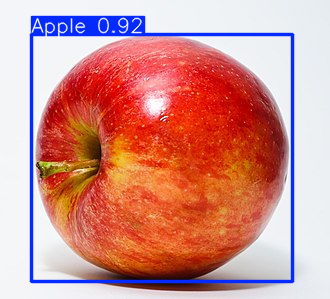

In [6]:
# Load the trained model
model = YOLO('/kaggle/working/YOLOv8_Food_Detection/food_detection/weights/best.pt')
# Make predictions on an image (adjust the path according to your structure)
results = model('/kaggle/input/test-user/maca.jpg')
# Show results
for r in results:
    r.show()


image 1/12 /kaggle/input/test-user/banana.jpg: 640x640 2 bananas, 8.6ms
image 2/12 /kaggle/input/test-user/brd.jpg: 384x640 1 Vada, 40.8ms
image 3/12 /kaggle/input/test-user/cola.jpg: 448x640 1 Soda, 40.5ms
image 4/12 /kaggle/input/test-user/cpt.jpg: 448x640 1 Chapathi, 6.4ms
image 5/12 /kaggle/input/test-user/fries.jpg: 448x640 1 Fries, 6.2ms
image 6/12 /kaggle/input/test-user/hbg.jpg: 384x640 1 burger, 8.1ms
image 7/12 /kaggle/input/test-user/maca.jpg: 608x640 1 Apple, 7.7ms
image 8/12 /kaggle/input/test-user/pera.jpg: 640x448 1 Apple, 39.6ms
image 9/12 /kaggle/input/test-user/pzz.webp: 384x640 1 Pizza, 7.9ms
image 10/12 /kaggle/input/test-user/rice.jpg: 448x640 1 Rice, 7.3ms
image 11/12 /kaggle/input/test-user/tomatoes.jpg: 448x640 (no detections), 6.7ms
image 12/12 /kaggle/input/test-user/val.jpg: 448x640 1 Vada, 6.7ms
Speed: 1.9ms preprocess, 15.5ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to /kaggle/working/predictions/predict


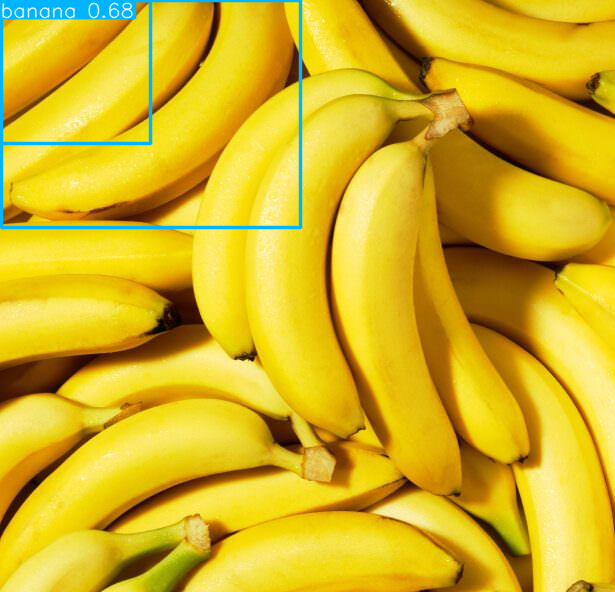

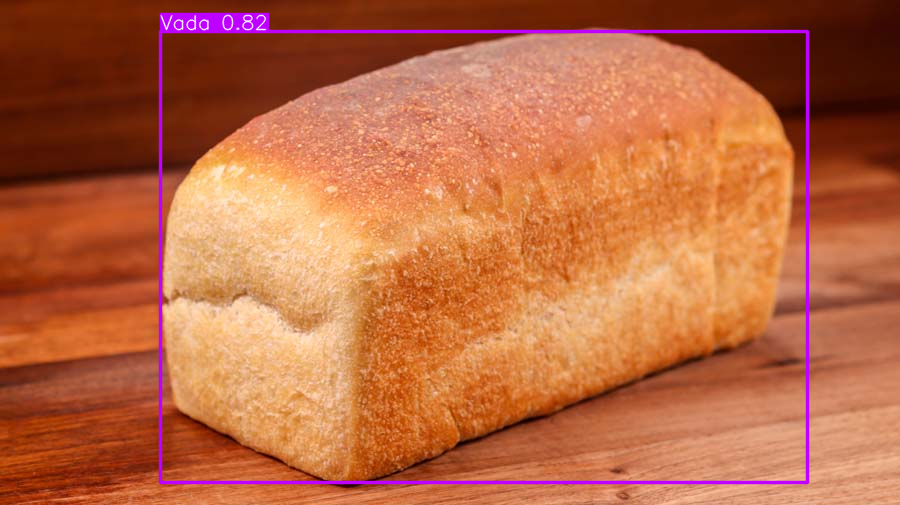

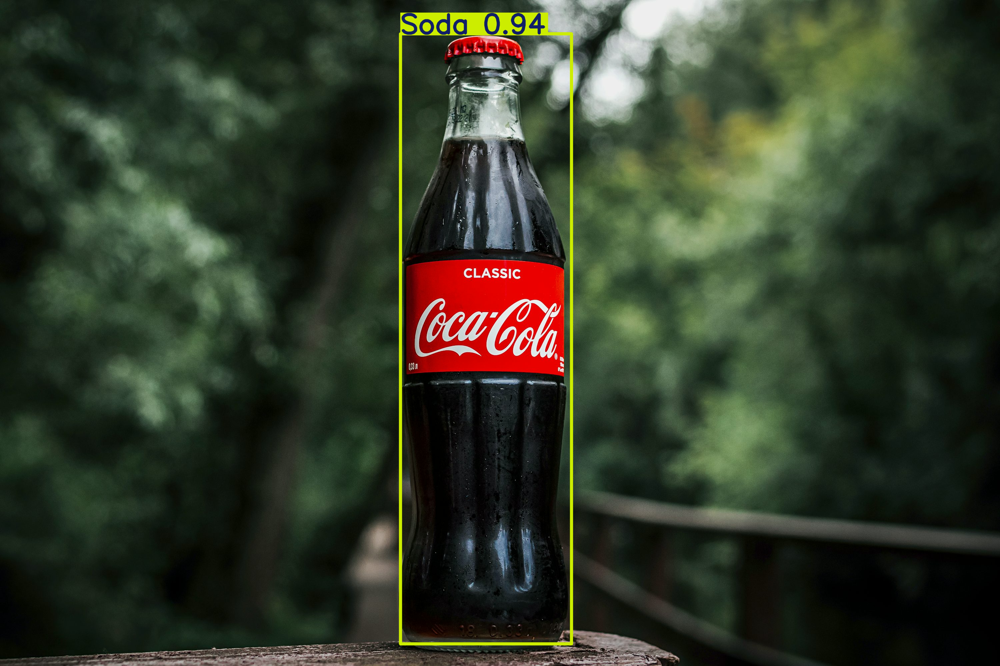

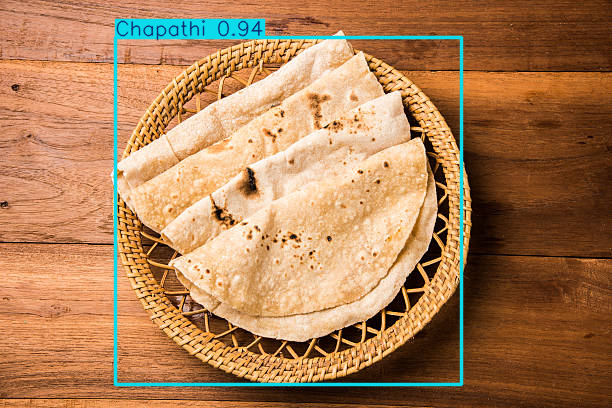

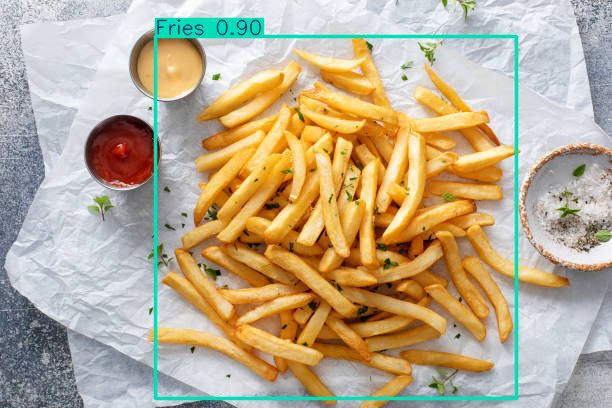

...

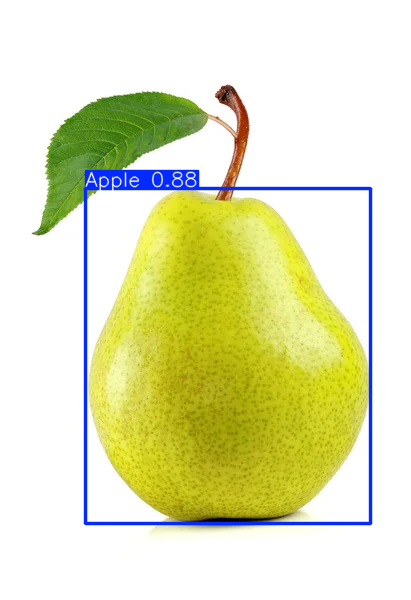

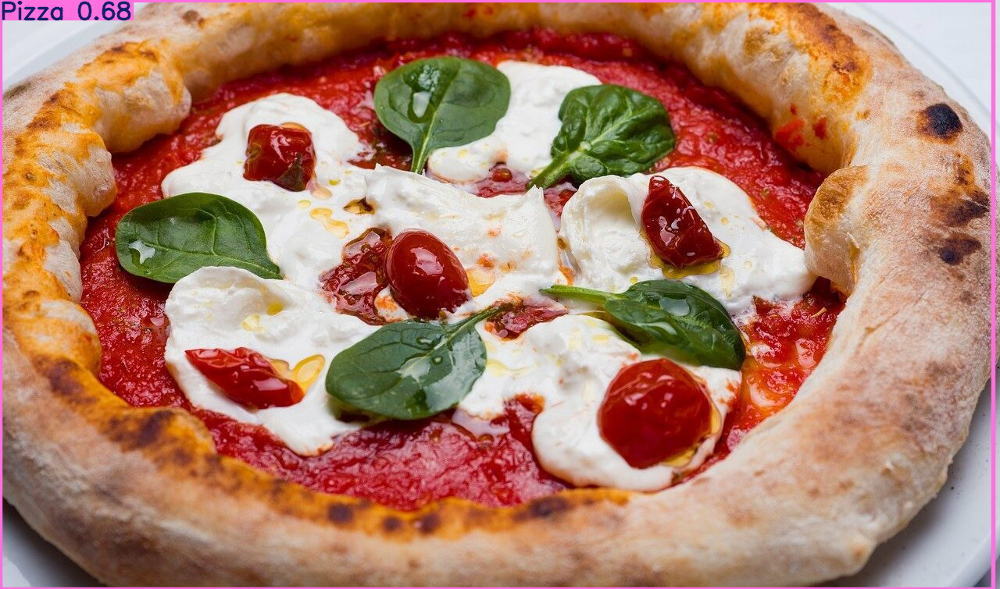

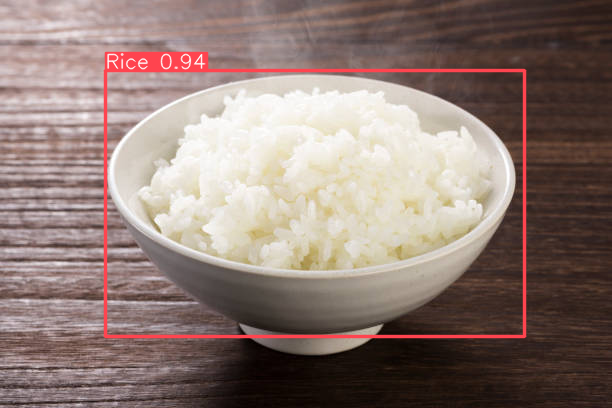

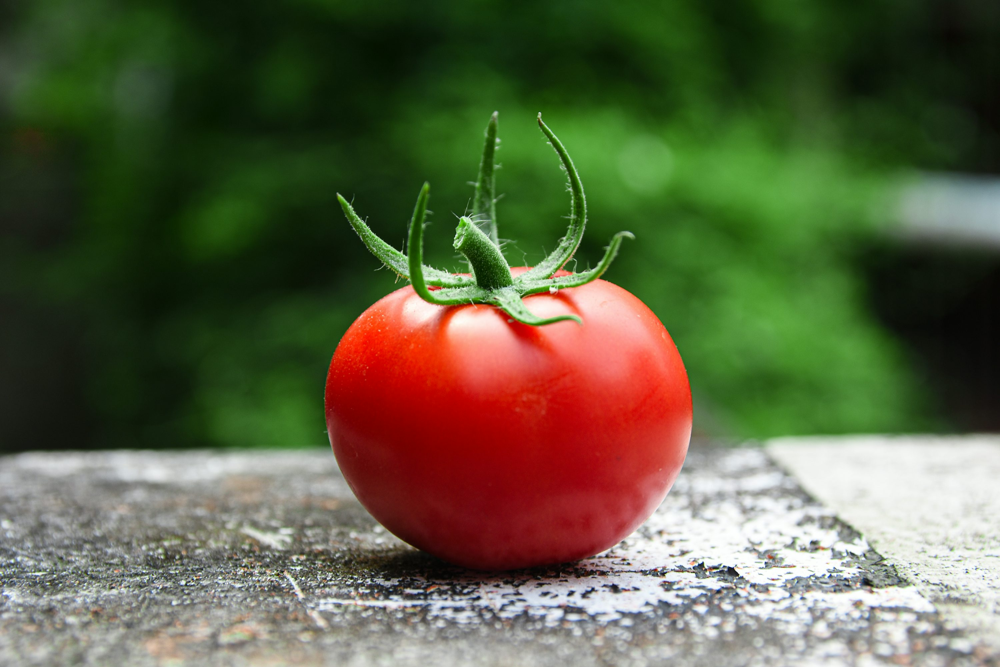

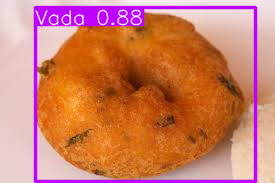

In [7]:
results = model.predict(
    source='/kaggle/input/test-user',
    save=True,
    conf=0.5,  # confidence threshold
    project='/kaggle/working/predictions'  # Save predictions
)
# Show results
for r in results:
    r.show()


In [8]:
# Optional: Save the final model
model.save('/kaggle/working/food_detection_final.pt')

In [9]:
# ========================================
# YOLOv8 com Informações Calóricas
# =======================================

In [10]:
!pip install ultralytics gradio

import gradio as gr
from ultralytics import YOLO
import cv2
import numpy as np
from PIL import Image
import os

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.3/54.3 MB 33.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 323.6/323.6 kB 18.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.3/95.3 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 102.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.4/62.4 kB 3.5 MB/s eta 0:00:00


In [11]:
# ========================================
# YOLOv8 with Caloric Information
# =======================================

In [12]:
FOOD_NUTRITION = {
    # Fruits
    'apple': {'calories': 52, 'protein': 0.3, 'carbs': 14, 'fat': 0.2, 'portion_size': 150},
    'banana': {'calories': 89, 'protein': 1.1, 'carbs': 23, 'fat': 0.3, 'portion_size': 120},
    
    # Vegetables
    'tomato': {'calories': 18, 'protein': 0.9, 'carbs': 3.9, 'fat': 0.2, 'portion_size': 100},
    
    # Processed foods
    'pizza': {'calories': 266, 'protein': 11, 'carbs': 33, 'fat': 10, 'portion_size': 150},
    'soda': {'calories': 42, 'protein': 0, 'carbs': 10.6, 'fat': 0, 'portion_size': 100},
    
    # Other common foods
    'burger': {'calories': 295, 'protein': 17, 'carbs': 30, 'fat': 12, 'portion_size': 150},
    'rice': {'calories': 130, 'protein': 2.7, 'carbs': 28, 'fat': 0.3, 'portion_size': 150},
    'chicken gravy': {'calories': 89, 'protein': 8.2, 'carbs': 4.5, 'fat': 4.8, 'portion_size': 100},
    'fries': {'calories': 365, 'protein': 4, 'carbs': 63, 'fat': 17, 'portion_size': 100},
    'chapathi': {'calories': 297 , 'protein': 2.5, 'carbs': 55.8, 'fat': 4.6, 'portion_size': 150},
    'idli': {'calories': 58 , 'protein': 27, 'carbs': 12, 'fat': 0.3, 'portion_size': 100},
    'vada': {'calories': 245 , 'protein': 8.5, 'carbs': 28, 'fat': 11.2, 'portion_size': 100}
}

In [13]:
# ========================================
# AUXILIARY FUNCTIONS
# ========================================

In [14]:
def get_nutrition_info(food_name, confidence=1.0):
    """
    Returns nutritional information for a food item
    """
    # Normalize food name
    food_key = food_name.lower().replace('_', ' ')
    
    # Search in database
    nutrition = FOOD_NUTRITION.get(food_key)
    
    if nutrition:
        portion_size = nutrition['portion_size']  # grams of typical portion
        
        # Calculate values for the portion
        portion_calories = (nutrition['calories'] * portion_size) / 100
        portion_protein = (nutrition['protein'] * portion_size) / 100
        portion_carbs = (nutrition['carbs'] * portion_size) / 100
        portion_fat = (nutrition['fat'] * portion_size) / 100
        
        return {
            'found': True,
            'portion_size': portion_size,
            'calories_per_100g': nutrition['calories'],
            'calories_per_portion': round(portion_calories),
            'protein': round(portion_protein, 1),
            'carbs': round(portion_carbs, 1),
            'fat': round(portion_fat, 1),
            'confidence': confidence
        }
    else:
        return {
            'found': False,
            'food_name': food_name
        }

def calculate_total_nutrition(detections):
    """
    Calculates total nutrition from all detections
    """
    total_calories = 0
    total_protein = 0
    total_carbs = 0
    total_fat = 0
    valid_items = 0
    
    for detection in detections:
        nutrition = get_nutrition_info(detection['name'], detection['confidence'])
        if nutrition['found']:
            total_calories += nutrition['calories_per_portion']
            total_protein += nutrition['protein']
            total_carbs += nutrition['carbs']
            total_fat += nutrition['fat']
            valid_items += 1
    
    return {
        'total_calories': round(total_calories),
        'total_protein': round(total_protein, 1),
        'total_carbs': round(total_carbs, 1),
        'total_fat': round(total_fat, 1),
        'valid_items': valid_items
    }

In [15]:
# ========================================
# LOAD MODEL
# ========================================

In [16]:
# Try to load trained model, otherwise use default
model_paths = [
    '/kaggle/input/test-model/food_detection_final.pt',
    '/kaggle/input/test-model/food_detection_final.pt',
    'yolov8s.pt'
]
model = None
model_info = ""
for path in model_paths:
    if os.path.exists(path):
        model = YOLO(path)
        if 'kaggle' in path:
            model_info = "🎯 Using custom trained model"
        else:
            model_info = "📊 Using default YOLO model (COCO dataset)"
        break
if model is None:
    model = YOLO('yolov8s.pt')
    model_info = "📊 Using default YOLO model (COCO dataset)"

In [17]:
# ========================================
# MAIN DETECTION FUNCTION
# ========================================

In [18]:
def detect_food_with_nutrition(image, confidence_threshold, show_nutrition=True):
    """
    Detects food and calculates nutritional information
    """
    if image is None:
        return None, "Please upload an image", ""
    
    try:
        # Make prediction
        results = model.predict(image, conf=confidence_threshold, verbose=False)
        
        # Image with detections
        annotated_image = results[0].plot()
        
        # Extract detections
        detections = []
        if results[0].boxes is not None:
            for box in results[0].boxes:
                cls_id = int(box.cls[0])
                conf = float(box.conf[0])
                class_name = model.names[cls_id]
                
                detections.append({
                    'name': class_name,
                    'confidence': conf
                })
        
        # Create detailed report
        if detections:
            result_text = f"🍽️ **DETECTED FOODS ({len(detections)} items):**\n\n"
            
            nutrition_details = []
            
            for i, detection in enumerate(detections, 1):
                name = detection['name']
                conf = detection['confidence']
                
                result_text += f"**{i}. {name.title()}** (Confidence: {conf:.2f})\n"
                
                if show_nutrition:
                    nutrition = get_nutrition_info(name, conf)
                    
                    if nutrition['found']:
                        result_text += f"   📊 **Typical portion:** {nutrition['portion_size']}g\n"
                        result_text += f"   🔥 **Calories:** {nutrition['calories_per_portion']} kcal\n"
                        result_text += f"   🥩 **Protein:** {nutrition['protein']}g\n"
                        result_text += f"   🌾 **Carbohydrates:** {nutrition['carbs']}g\n"
                        result_text += f"   🧈 **Fat:** {nutrition['fat']}g\n"
                        
                        nutrition_details.append(nutrition)
                    else:
                        result_text += f"   ❓ **Nutritional information not available**\n"
                
                result_text += "\n"
            
            # Total nutritional summary
            if show_nutrition and nutrition_details:
                totals = calculate_total_nutrition(detections)
                
                summary_text = f"""
📋 **TOTAL NUTRITIONAL SUMMARY:**\n
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━\n
🔥 **Total calories:** {totals['total_calories']} kcal\n
🥩 **Total protein:** {totals['total_protein']}g \n 
🌾 **Total carbohydrates:** {totals['total_carbs']}g\n
🧈 **Total fat:** {totals['total_fat']}g\n
📊 **Analysis:**\n
- Based on {totals['valid_items']} identified food item(s)
- Values per typical portions
- Daily intake percentage (2500 kcal): {round((totals['total_calories']/2500)*100, 1)}%\n
💡 **Note:** Approximate values based on standard portions
"""
            else:
                summary_text = ""
        
        else:
            result_text = "❌ No food detected with this confidence level"
            summary_text = ""
        
        return annotated_image, result_text, summary_text
        
    except Exception as e:
        error_img = np.zeros((400, 400, 3), dtype=np.uint8)
        return error_img, f"❌ Error: {str(e)}", ""

In [19]:
# ========================================
# GRADIO INTERFACE
# ========================================

In [20]:
def create_nutrition_interface():
    """
    Create interface with nutritional information
    """
    with gr.Blocks(
        title="🍽️ Food Detector + Calories",
        theme=gr.themes.Soft()
    ) as interface:
        
        gr.Markdown(f"""
        # 🍽️ Food Detector with Nutritional Analysis
        
        {model_info}
        
        **Features:**
        - 🔍 Automatic food detection
        - 🔥 Calorie calculation per portion
        - 📊 Complete nutritional information  
        - 📋 Total nutritional summary
        
        ---
        """)
        
        with gr.Row():
            with gr.Column(scale=1):
                # Image input
                input_image = gr.Image(
                    label="📸 Image Upload",
                    type="pil",
                    height=400
                )
                
                # Controls
                with gr.Row():
                    confidence_slider = gr.Slider(
                        minimum=0.1,
                        maximum=0.9,
                        value=0.4,
                        step=0.05,
                        label="🎯 Minimum Confidence"
                    )
                    
                    show_nutrition_check = gr.Checkbox(
                        value=True,
                        label="📊 Show Nutrition"
                    )
                
                # Buttons
                with gr.Row():
                    analyze_btn = gr.Button(
                        "🔍 Analyze Foods",
                        variant="primary",
                        size="lg"
                    )
                    
                    clear_btn = gr.Button(
                        "🗑️ Clear",
                        variant="secondary"
                    )
            
            with gr.Column(scale=1):
                # Image output
                output_image = gr.Image(
                    label="🎯 Detections",
                    height=400
                )
                
                # Result tabs
                with gr.Tabs():
                    with gr.TabItem("📋 Details"):
                        details_output = gr.Markdown(
                            value="Upload an image to get started...",
                            height=300
                        )
                    
                    with gr.TabItem("📊 Summary"):
                        summary_output = gr.Markdown(
                            value="Waiting for analysis...",
                            height=300
                        )
        
        # Examples and tips
        gr.Markdown("""
        ### 💡 Tips for better results:
        - Use well-lit and focused images
        - Avoid excessive food overlap  
        - Adjust confidence as needed
        - Caloric values are approximate per typical portions
        """)
        
        # Connect events
        analyze_btn.click(
            fn=detect_food_with_nutrition,
            inputs=[input_image, confidence_slider, show_nutrition_check],
            outputs=[output_image, details_output, summary_output]
        )
        
        clear_btn.click(
            fn=lambda: (None, "Image cleared", ""),
            outputs=[input_image, details_output, summary_output]
        )
    
    return interface

In [21]:
# ========================================
# LAUNCH INTERFACE
# ========================================

In [22]:
if __name__ == "__main__":
    print("🚀 Starting Food Detector with Nutritional Analysis...")
    print(model_info)
    
    interface = create_nutrition_interface()
    interface.launch(
        share=True,
        server_name="0.0.0.0",
        show_error=True
    )
    
    print("✅ Interface launched successfully!")

🚀 Starting Food Detector with Nutritional Analysis...
🎯 Using custom trained model
* Running on local URL:  http://0.0.0.0:7860
* Running on public URL: https://06e9b4732206af723a.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


✅ Interface launched successfully!
